<a href="https://colab.research.google.com/github/SoheilBadri2000/DataScience2/blob/main/43.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLO v3

In [ ]:
!git clone https://github.com/pjreddie/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 5955, done.
remote: Total 5955 (delta 0), reused 0 (delta 0), pack-reused 5955
Receiving objects: 100% (5955/5955), 6.37 MiB | 8.10 MiB/s, done.
Resolving deltas: 100% (3932/3932), done.


In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights

--2024-06-22 02:56:37--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 162.0.215.52
Connecting to pjreddie.com (pjreddie.com)|162.0.215.52|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  52.8MB/s    in 4.5s    

2024-06-22 02:56:41 (52.2 MB/s) - ‘yolov3.weights’ saved [248007048/248007048]



In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from IPython.display import clear_output

In [ ]:
# Load YOLOv3 network
net = cv2.dnn.readNet("/content/yolov3.weights", "/content/darknet/cfg/yolov3.cfg")

In [ ]:
# List of classes
with open("/content/darknet/data/coco.names", "r") as f:
  classes = [line.strip() for line in f.readlines()]
  print(len(classes))
  print(classes)

80
['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


In [ ]:
# Overview of the layer names
layer_names = net.getLayerNames()
print(len(layer_names))
print(layer_names)

# Access to output layers
output_layers = net.getUnconnectedOutLayersNames()
print(len(output_layers))
print(output_layers)

254
('conv_0', 'bn_0', 'leaky_1', 'conv_1', 'bn_1', 'leaky_2', 'conv_2', 'bn_2', 'leaky_3', 'conv_3', 'bn_3', 'leaky_4', 'shortcut_4', 'conv_5', 'bn_5', 'leaky_6', 'conv_6', 'bn_6', 'leaky_7', 'conv_7', 'bn_7', 'leaky_8', 'shortcut_8', 'conv_9', 'bn_9', 'leaky_10', 'conv_10', 'bn_10', 'leaky_11', 'shortcut_11', 'conv_12', 'bn_12', 'leaky_13', 'conv_13', 'bn_13', 'leaky_14', 'conv_14', 'bn_14', 'leaky_15', 'shortcut_15', 'conv_16', 'bn_16', 'leaky_17', 'conv_17', 'bn_17', 'leaky_18', 'shortcut_18', 'conv_19', 'bn_19', 'leaky_20', 'conv_20', 'bn_20', 'leaky_21', 'shortcut_21', 'conv_22', 'bn_22', 'leaky_23', 'conv_23', 'bn_23', 'leaky_24', 'shortcut_24', 'conv_25', 'bn_25', 'leaky_26', 'conv_26', 'bn_26', 'leaky_27', 'shortcut_27', 'conv_28', 'bn_28', 'leaky_29', 'conv_29', 'bn_29', 'leaky_30', 'shortcut_30', 'conv_31', 'bn_31', 'leaky_32', 'conv_32', 'bn_32', 'leaky_33', 'shortcut_33', 'conv_34', 'bn_34', 'leaky_35', 'conv_35', 'bn_35', 'leaky_36', 'shortcut_36', 'conv_37', 'bn_37', 'le

In [ ]:
!wget https://images.unsplash.com/photo-1546636889-ba9fdd63583e
!mv photo-1546636889-ba9fdd63583e street.jpg

--2024-06-22 03:02:13--  https://images.unsplash.com/photo-1546636889-ba9fdd63583e
Resolving images.unsplash.com (images.unsplash.com)... 151.101.2.208, 151.101.66.208, 151.101.130.208, ...
Connecting to images.unsplash.com (images.unsplash.com)|151.101.2.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2433161 (2.3M) [image/jpeg]
Saving to: ‘photo-1546636889-ba9fdd63583e’

photo-1546636889-ba 100%[===================>]   2.32M  --.-KB/s    in 0.04s   

2024-06-22 03:02:13 (52.1 MB/s) - ‘photo-1546636889-ba9fdd63583e’ saved [2433161/2433161]



In [ ]:
# Load an image
img = cv2.imread("street.jpg")
img = cv2.resize(img, None, fx=0.4, fy=0.4)
height, width, channels = img.shape

In [ ]:
# Detect objects in the image
blob = cv2.dnn.blobFromImage(img, 0.00392, (442, 442), (0, 0, 0), True, crop=False)
net.setInput(blob)
outs = net.forward(output_layers)
outs[0].shape # [number_of_detections, 4 + 1 + number_of_classes]

(588, 85)

In [ ]:
# Show detection
class_ids, confidences, boxes = [], [], []
for out in outs:
  for detection in out:
    scores = detection[5:]
    class_id = np.argmax(scores)
    confidence = scores[class_id]
    if confidence > 0.5:
      # Object detected
      center_x, center_y, w, h = (detection[0:4] * np.array([width, height, width, height])).astype("int")
      x, y = int(center_x - w / 2), int(center_y - h / 2)
      boxes.append([x, y, int(w), int(h)])
      confidences.append(float(confidence))
      class_ids.append(class_id)

In [ ]:
# Perform non-maximum suppression to eliminate redundant overlapping boxes with lower confidences
indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

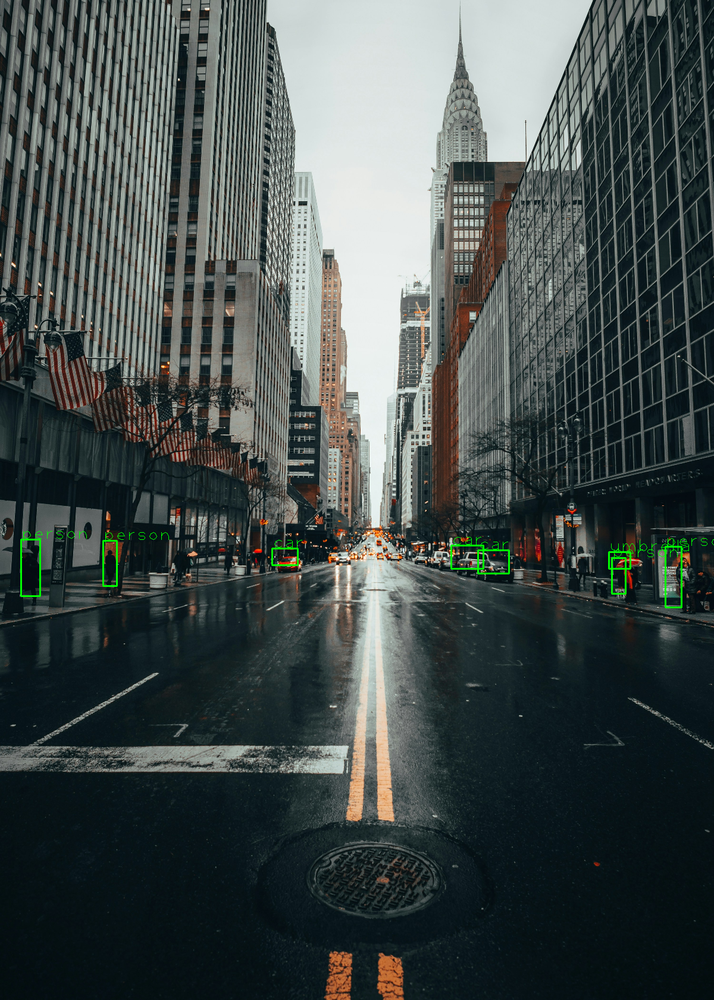

In [ ]:
# Draw the bounding boxes
for i in range(len(boxes)):
  if i in indexes:
    x, y, w, h = boxes[i]
    label = str(classes[class_ids[i]])
    color = (0, 255, 0)
    cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
    cv2.putText(img, label, (x, y), 1, 2, color, 1)

cv2_imshow(img)

In [36]:
!wget https://static.videezy.com/system/resources/previews/000/020/724/original/P1033684.mp4
!mv P1033684.mp4 street.mp4

--2024-06-22 03:06:36--  https://static.videezy.com/system/resources/previews/000/020/724/original/P1033684.mp4
Resolving static.videezy.com (static.videezy.com)... 104.18.40.253, 172.64.147.3, 2606:4700:4400::6812:28fd, ...
Connecting to static.videezy.com (static.videezy.com)|104.18.40.253|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3657426 (3.5M) [video/mp4]
Saving to: ‘P1033684.mp4’

P1033684.mp4        100%[===================>]   3.49M  --.-KB/s    in 0.06s   

2024-06-22 03:06:37 (55.9 MB/s) - ‘P1033684.mp4’ saved [3657426/3657426]



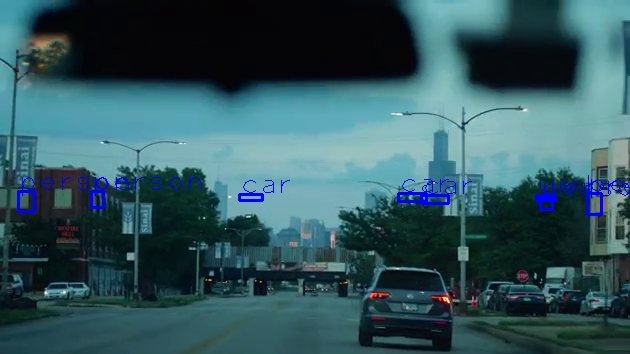

KeyboardInterrupt: 

In [38]:
cap = cv2.VideoCapture("street.mp4")

while True:
  # read a frame from the video
  ret, frame = cap.read() # ret is a flag variable (True, False)
  if not ret:
    break

  height, width, channels = frame.shape
  blob = cv2.dnn.blobFromImage(frame, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
  net.setInput(blob)
  out = net.forward(output_layers)

  class_ids, confidences, boxes = [], [], []
  for out in outs:
    for detection in out:
      scores = detection[5:]
      class_id = np.argmax(scores)
      confidence = scores[class_id]
      if confidence > 0.5:
        center_x, center_y, w, h = (detection[0:4] * np.array([width, height, width, height])).astype("int")
        x, y = int(center_x - w / 2), int(center_y - h / 2)
        boxes.append([x, y, int(w), int(h)])
        confidences.append(float(confidence))
        class_ids.append(class_id)

  indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

  for i in range(len(boxes)):
    if i in indexes:
      x, y, w, h = boxes[i]
      label = str(classes[class_ids[i]])
      color = (255, 0, 0)
      cv2.rectangle(frame, (x, y), (x + w, y + h), color, 2)
      cv2.putText(frame, label, (x, y), 1, 2, color, 1)

  clear_output(wait=True)
  cv2_imshow(frame)
  if cv2.waitKey(1) == ord("q"):
    break

cap.release()
cv2.destroyAllWindows()

# YOLO v5

In [40]:
import torch
import cv2
import matplotlib.pyplot as plt

/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0', 'requests>=2.32.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 160.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 248.5 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.31.0
    Uninstalling requests-2.31.0:
      Successfully uninstalled requests-2.31.0
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0

requirements: AutoUpdate success ✅ 10.1s, installed 3 packages: ['gitpython>=3.1.30', 'pillow>=10.3.0', 'requests>=2.32.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5 🚀 2024-6-22 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

100%|██████████| 14.1M/14.1M [00:00<00:00, 192MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1: 4200x3000 6 persons, 6 cars
Speed: 12.2ms pre-process, 135.9ms inference, 929.2ms NMS per image at shape (1, 3, 640, 480)


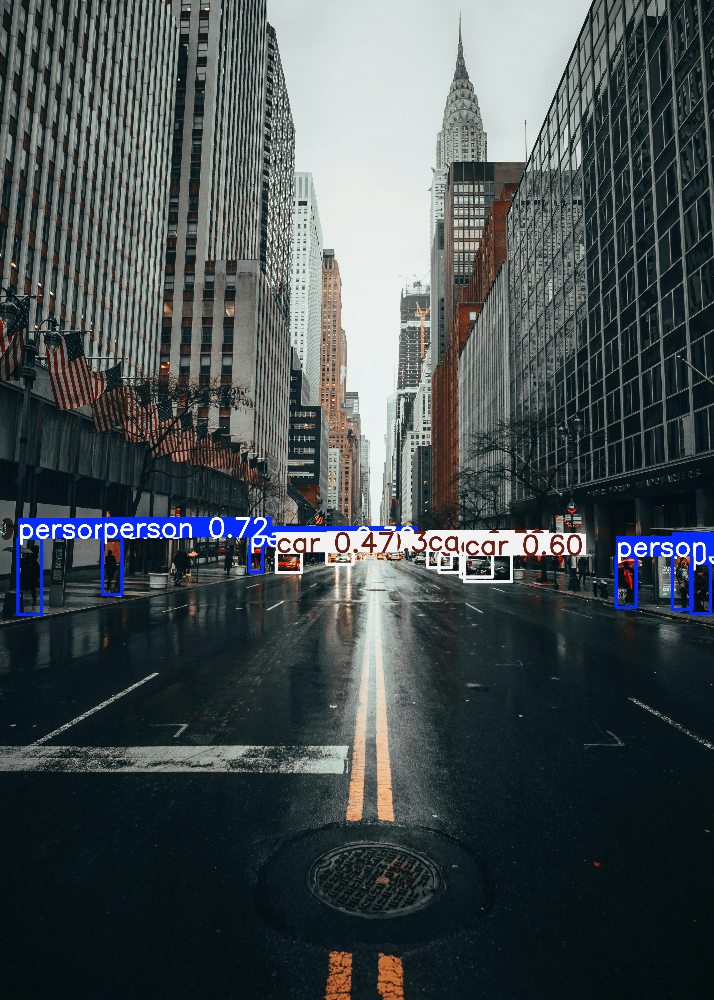

In [41]:
from ast import mod
# Load the YOLO v5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s') # Load the YOLO v5 small model

# Function to perform detecction
def detect_objects(image_path):
  # Load image
  img = cv2.imread(image_path)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Perform detection
  results = model(img_rgb)
  # Results
  results.print()
  results.show()

# Example usage
image_path = "street.jpg"
detect_objects(image_path)